# A notebook to plot the results of the ML models

In [1]:
import pickle as pk
import pandas as pd
import numpy as np

from collections import defaultdict

import scipy.stats as st
import matplotlib.pyplot as plt 

from ElMD import ElMD 

from sklearn.metrics import mean_absolute_error as mae, \
                            r2_score as r2, \
                            accuracy_score as acc, \
                            matthews_corrcoef as mcc

# Create Tables for Each Task

In [9]:
results = {}

models = [ "ContShuffle_Reg", "ContMean_Reg","AutoSklearn_Reg", "CrabNet_Reg", "TransferCrabNet_Reg", "ContShuffle_Clf",  "ContMean_Clf", "AutoSklearn_Clf", "CrabNet_Clf", "TransferCrabNet_Clf"]

res = {}

all_runs = []

for cv in ["LOCO", "Kfold"]:
    for model_type in models:
        run_aves = [[], [], []]

        n_runs = 5 

        for run in range(n_runs):

            run_maes = []
            run_r2s = []

            for i in range(9 if cv == "LOCO" else 5):
                name = f"{cv}_{model_type}_run_{run}_fold_{i}"
                # print(name)
                if "Auto" in name:
                    res_df = pd.read_csv(f"results/predictions3/{name}.csv")
                else:
                    res_df = pd.read_csv(f"results/predictions3/{name}.csv")

                if "Clf" in model_type:
                    run_maes.append(mcc(res_df['real'].to_numpy(dtype=int), res_df['pred'].to_numpy(dtype=int)))
                    run_r2s.append(acc(res_df['real'], res_df['pred']))

                    # if run_r2s[-1] == 1 and run_maes[-1] == 0:
                    #     run_maes[-1] = 1
                else:
                    run_maes.append(mae(res_df['real'], res_df['pred']))
                    run_r2s.append(r2(res_df['real'], res_df['pred']))

            run_aves[0].append(name[:-7])
            run_aves[1].append(np.mean(run_maes))
            run_aves[2].append(np.mean(run_r2s))

        all_runs.append((run_aves[0][0][:-6], np.mean(run_aves[1]), np.std(run_aves[1]), np.mean(run_aves[2]), np.std(run_aves[2])))

/home/cameron/miniconda3/envs/ionics/lib/python3.8/site-packages/sklearn/metrics/_classification.py:870: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/cameron/miniconda3/envs/ionics/lib/python3.8/site-packages/sklearn/metrics/_classification.py:870: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/cameron/miniconda3/envs/ionics/lib/python3.8/site-packages/sklearn/metrics/_classification.py:870: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/cameron/miniconda3/envs/ionics/lib/python3.8/site-packages/sklearn/metrics/_classification.py:870: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/cameron/miniconda3/envs/ionics/lib/python3.8/site-packages/sklearn/metrics/_classification.py:870: RuntimeWarning: invalid value encountered i

In [10]:
pd.DataFrame([x for x in all_runs if "Reg" in x[0]], columns=["Model", "MAE", "MAE_std", "R2", "R2_std"])

,Model,MAE,MAE_std,R2,R2_std
0,LOCO_ContShuffle_Reg,2.427083,0.084877,-2.683637,0.379476
1,LOCO_ContMean_Reg,1.729889,0.000000,-0.464381,0.000000
2,LOCO_AutoSklearn_Reg,1.616257,0.081409,-0.350247,0.228836
3,LOCO_CrabNet_Reg,1.130972,0.006594,0.145520,0.038739
4,LOCO_TransferCrabNet_Reg,0.993760,0.025875,0.330662,0.023696
5,Kfold_ContShuffle_Reg,2.306809,0.061444,-0.998793,0.134389
6,Kfold_ContMean_Reg,1.710067,0.000000,-0.004218,0.000000
7,Kfold_AutoSklearn_Reg,1.099759,0.040298,0.455656,0.053745
8,Kfold_CrabNet_Reg,0.959715,0.021166,0.548347,0.026115
9,Kfold_TransferCrabNet_Reg,0.854400,0.021010,0.624946,0.021298


In [12]:
pd.DataFrame([x for x in all_runs if "Clf" in x[0]], columns=["Model", "MCC", "MCC_std", "Acc", "Acc_std"])

,Model,MCC,MCC_std,Acc,Acc_std
0,LOCO_ContShuffle_Clf,0.002533,0.070478,0.518952,0.037947
1,LOCO_ContMean_Clf,0.000000,0.000000,0.642700,0.000000
2,LOCO_AutoSklearn_Clf,0.105191,0.052031,0.639044,0.034198
3,LOCO_CrabNet_Clf,0.363831,0.015064,0.620122,0.016831
4,LOCO_TransferCrabNet_Clf,0.384646,0.012536,0.713923,0.014390
5,Kfold_ContShuffle_Clf,-0.022560,0.032807,0.500648,0.015784
6,Kfold_ContMean_Clf,0.000000,0.000000,0.575679,0.000000
7,Kfold_AutoSklearn_Clf,0.466774,0.039540,0.739611,0.018773
8,Kfold_CrabNet_Clf,0.569318,0.013634,0.786198,0.006105
9,Kfold_TransferCrabNet_Clf,0.633063,0.022368,0.814994,0.009218


# Create Plots of the Regression Control Models

First we will define two helper functions to take in the model name, read in the data and plot parity plots and error distributions

In [2]:
def plot_act_pred(fpath, ax=None):
    comps = []
    preds = []
    reals = []
    
    n_runs = 5
    
    for i in range(9 if "LOCO" in fpath else 5):
        for run in range(n_runs):
            name = f"{fpath}_run_{run}_fold_{i}"
            res_df = pd.read_csv(f"results/predictions3/{name}.csv")

            comps += [x for x in res_df["composition"].to_list()]
            preds += [x for x in res_df["pred"].to_list()]
            reals += [x for x in res_df["real"].to_list()]
    
    comp_lookup = defaultdict(defaultdict)

    for i, comp in enumerate(comps):
        if comp not in comp_lookup:
            comp_lookup[comp]["real"] = []
            comp_lookup[comp]["pred"] = []

        comp_lookup[comp]["real"].append(reals[i])
        comp_lookup[comp]["pred"].append(preds[i])

    for k, v in comp_lookup.items():
        # print(k, v)
        ax.scatter(np.mean(v["real"]), np.mean(v["pred"]), color="k", s=7)

    ax.plot([-15, 0], [-15, 0], '--', color="steelblue")

    ax.set_xticks(range(-14, 2, 2), )
    ax.set_yticks(range(-14, 2, 2))
    
    ax.tick_params(axis='x', labelsize= 12)
    ax.tick_params(axis='y', labelsize= 12)

    ax.set_box_aspect(aspect=1)
    
def plot_errors(fpath, ax=None):
    n_runs = 5
    comps = []
    preds = []
    reals = []
    
    for i in range(9 if "LOCO" in fpath else 5):       
        for run in range(n_runs):
            name = f"{fpath}_run_{run}_fold_{i}"
            res_df = pd.read_csv(f"results/predictions3/{name}.csv")

            comps += [x for x in res_df["composition"].to_list()]
            preds += [x for x in res_df["pred"].to_list()]
            reals += [x for x in res_df["real"].to_list()]

    comp_lookup = defaultdict(dict)

    for i, comp in enumerate(comps):
        if comp not in comp_lookup:
            comp_lookup[comp]["real"] = []
            comp_lookup[comp]["pred"] = []

        comp_lookup[comp]["real"].append(reals[i])
        comp_lookup[comp]["pred"].append(preds[i])
        
    for k, v in comp_lookup.items():
        comp_lookup[k]["errors"] = [comp_lookup[k]["real"][i] - comp_lookup[k]["pred"][i] for i in range(len(comp_lookup[k]["pred"]))]

    all_errors = [-e for k in comp_lookup.keys() for e in comp_lookup[k]["errors"]]
    # Plot the Histogram
    n,bins,patches = ax.hist(all_errors, bins=31, color='k', density=True, zorder=2)

    # estimate distribution parameters, in this case (a, loc, scale)
    params = st.t.fit(all_errors)

    # evaluate PDF
    x = np.linspace(-6, 10, 1000)
    pdf = st.t.pdf(x, *params)
    ax.plot(x, pdf, '--r', color='#ffc200', zorder=3)
    
    # First Confidence Interval
    upper, lower = st.t.interval(0.68, len(all_errors), params[1], params[2])
    ax.axvline(x=lower, color='#009eff', linestyle='--', zorder=1)
    ax.axvline(x=upper, color='#009eff', linestyle='--', zorder=1)
    
    # Second Confidence Interval
    upper, lower = st.t.interval(0.95, len(all_errors), params[1], params[2])
    ax.axvline(x=lower, color='#00b4ff', linestyle='--', zorder=1)
    ax.axvline(x=upper, color='#00b4ff', linestyle='--', zorder=1)
    
    # Third Confidence Interval
    upper, lower = st.t.interval(0.99, len(all_errors), params[1], params[2])
    ax.axvline(x=lower, color='#43c4ef', linestyle='--', zorder=1)
    ax.axvline(x=upper, color='#43c4ef', linestyle='--', zorder=1)
    
    # Mean Line of PDF
    ax.axvline(x=params[1], color='#0066ff', linestyle='--', zorder=1)
    print(params[1])
    upper, lower = st.t.interval(0.67, len(all_errors), params[1], params[2])
    print(lower)
    print(upper)

    ax.set_title(fpath)
    
    ax.set_xticks(range(-8, 11, 2))
    ax.set_xlim([-7, 11])
    
    ax.set_ylim([0, 0.7])
    ax.set_yticks(np.linspace(0, 0.7, int(19/2)))
    ax.set_yticklabels([int(len(comp_lookup) * x) for x in np.linspace(0, 0.7, int(19/2))])

    ax.set_box_aspect(aspect=1)

    ax.tick_params(axis='x', labelsize= 12)
    ax.tick_params(axis='y', labelsize= 12)

    return np.histogram(all_errors, bins=31, density=True), all_errors, params



The control models

-0.028178619386102347
2.31320927609246
-2.369566514864666
-0.4443006191498208
1.0982492124320737
-1.9868504507317164


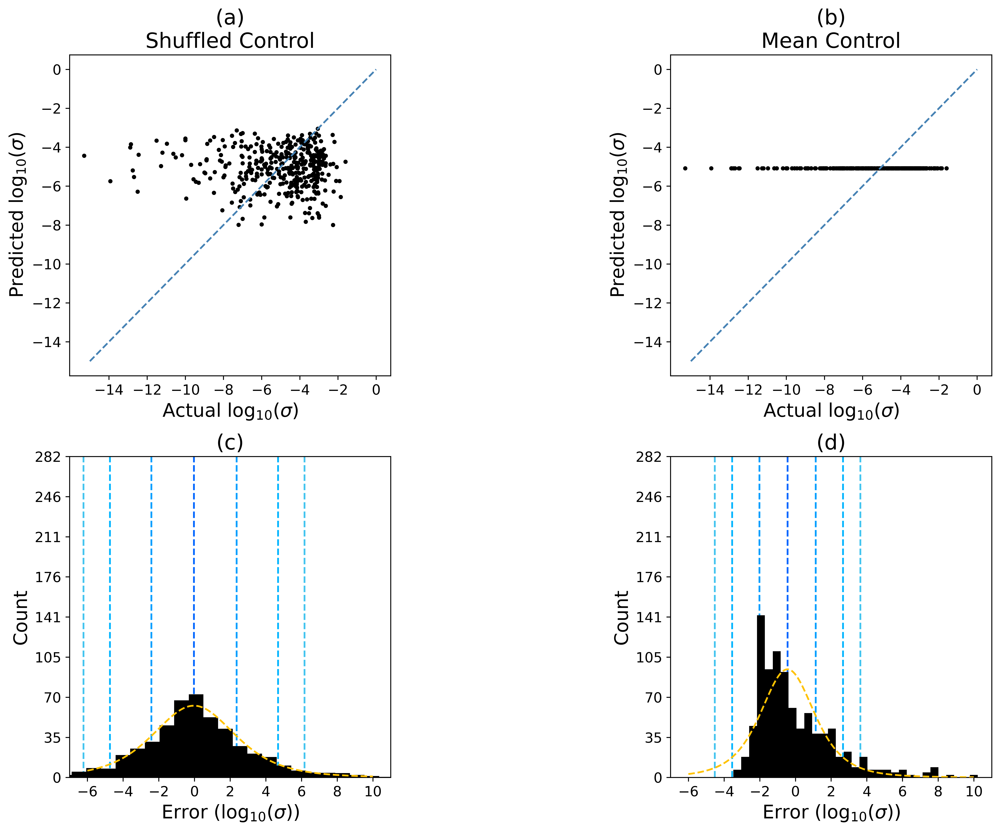

In [4]:
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(15.8, 10), dpi=600)
axs = axs.flat 

models = ["ContShuffle_Reg", "ContMean_Reg"]
titles = ["Shuffled Control", "Mean Control"]

count = 0

for i, cv in enumerate(["LOCO", "Kfold", "LOCO", "Kfold"]):
    fpath = f"{cv}_{models[i % 2]}"

    if count < 2:
        plot_act_pred(fpath, axs[count])
        axs[count].set_title(f"({chr(i + 97)})\n{titles[i % 2]}", fontsize=18)
    else:
        plot_errors(fpath, axs[count])
        axs[count].set_title(f"({chr(i + 97)})", fontsize=18)

    if count < 2:   
        axs[count].set_xlabel(r"Actual log$_{10}(\sigma$)", fontsize=16)
        axs[count].set_ylabel(r"Predicted log$_{10}(\sigma$)", fontsize=16)

    else:
        axs[count].set_xlabel(r"Error (log$_{10}(\sigma$))", fontsize=16)
        axs[count].set_ylabel("Count", fontsize=16)

    count += 1

fig.tight_layout()

fig.savefig("img/Figure5.eps")

The ML models

In [5]:

models = ["AutoSklearn_Reg", "TransferCrabNet_Reg", "TransferCrabNet_Reg"]
titles = ["AutoSklearn", "Transfer CrabNet", "Transfer CrabNet"]

fig, axs = plt.subplots(nrows=2, ncols=3, figsize=(15.8, 10), dpi=600)
axs = axs.flat 

count = 0

for i, cv in enumerate(["LOCO", "LOCO", "Kfold", "LOCO", "LOCO", "Kfold"]):
    fpath = f"{cv}_{models[i % 3]}"

    if count < 3:
        plot_act_pred(fpath, axs[count])

    else:
        print(fpath)
        plot_errors(fpath, axs[count])

    axs[count].set_title(f"({chr(i + 97)})\n{titles[i % 3]} ({cv})", fontsize=18)

    if count < 3:   
        axs[count].set_xlabel(r"Actual log$_{10}(\sigma$)", fontsize=16)
        axs[count].set_ylabel(r"Predicted log$_{10}(\sigma$)", fontsize=16)

    else:
        axs[count].set_xlabel(r"Error (log$_{10}(\sigma$))", fontsize=16)
        axs[count].set_ylabel("Count", fontsize=16)

    count += 1

fig.tight_layout()
fig.savefig("img/Figure6.eps")


LOCO_AutoSklearn_Reg
-0.6831459729065195
0.8678862360920077
-2.2341781819050475
LOCO_TransferCrabNet_Reg
0.01638141466522837
0.8270766865226483
-0.7943138571921919
Kfold_TransferCrabNet_Reg
-0.013235351161138527
0.5730851768027968
-0.5995558791250741


Plot all models for SI

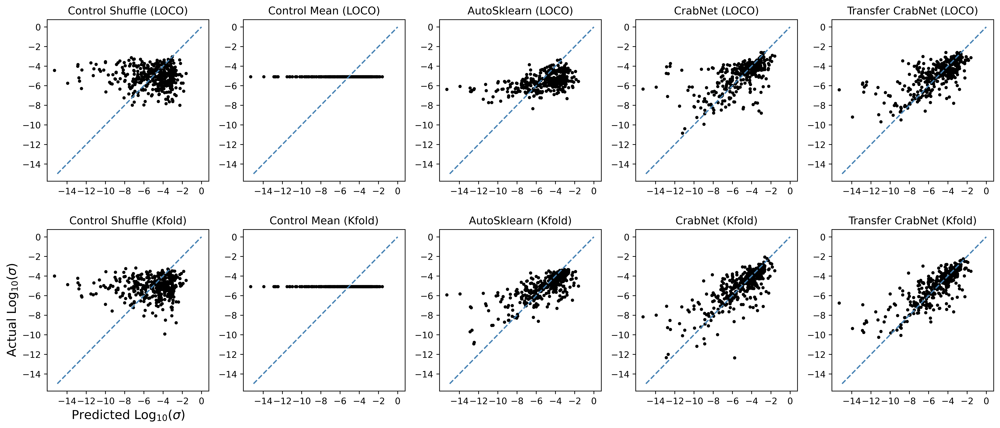

In [6]:

models = ["ContShuffle_Reg", "ContMean_Reg", "AutoSklearn_Reg", "CrabNet_Reg", "TransferCrabNet_Reg"]
titles = ["Control Shuffle", "Control Mean", "AutoSklearn", "CrabNet", "Transfer CrabNet"]

fig, axs = plt.subplots(nrows=2, ncols=5, figsize=(15.8, 7), dpi=600)
axs = axs.flat 

i = 0

for cv in ["LOCO", "Kfold"]:
    for j, model_type in enumerate(models):
        fpath = f"{cv}_{model_type}"
        plot_act_pred(fpath, axs[i])

        axs[i].set_title(f"{titles[j]} ({cv})")

        if i % 5 == 0 and i != 0:
            axs[i].set_ylabel(r"Actual Log$_{10}(\sigma$)", fontsize=14)
            axs[i].set_xlabel(r"Predicted Log$_{10}(\sigma$)", fontsize=14)

        axs[i].tick_params(axis = 'both', which = 'major', labelsize = 10)

        i += 1

fig.tight_layout()
fig.savefig("img/SupplementaryFigure9.eps")

Control Shuffle LOCO
-0.028178619386102347
2.31320927609246
-2.369566514864666
Control Mean LOCO
-0.4443006191498208
1.0982492124320737
-1.9868504507317164
AutoSklearn LOCO
-0.6831459729065195
0.8678862360920077
-2.2341781819050475
CrabNet LOCO
-0.05243249863919835
0.8236726100372743
-0.9285376073156714
Transfer CrabNet LOCO
0.01638141466522837
0.8270766865226483
-0.7943138571921919
Control Shuffle Kfold
0.0021094886614042557
2.3846635594198307
-2.3804445820970237
Control Mean Kfold
-0.4443006191498208
1.0982492124320737
-1.9868504507317164
AutoSklearn Kfold
-0.14151886815815673
0.7246765677581205
-1.0077143040744345
CrabNet Kfold
-0.0030358265087231185
0.7060314257729092
-0.7121030787903558
Transfer CrabNet Kfold
-0.013235351161138527
0.5730851768027968
-0.5995558791250741


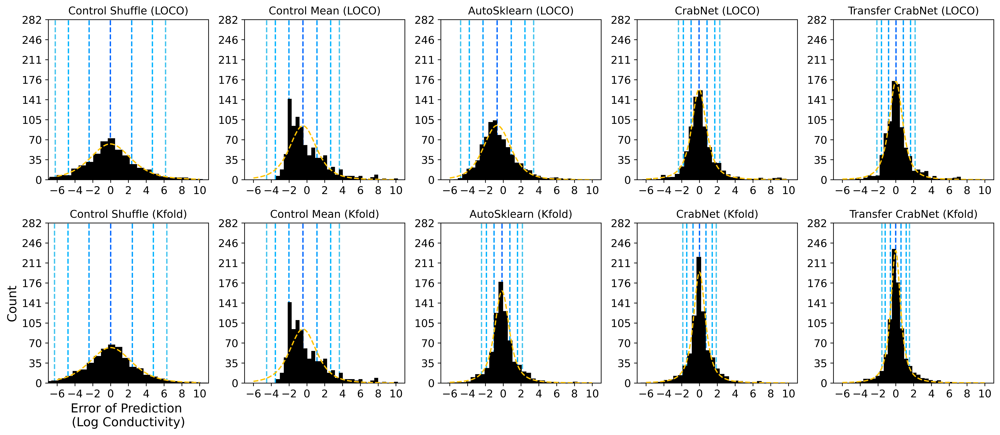

In [7]:

models = ["ContShuffle_Reg", "ContMean_Reg", "AutoSklearn_Reg", "CrabNet_Reg", "TransferCrabNet_Reg"]
titles = ["Control Shuffle", "Control Mean", "AutoSklearn", "CrabNet", "Transfer CrabNet"]

fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(15.8, 7), dpi=600)

axes = ax.flat 
i = 0

for cv in ["LOCO", "Kfold"]:
    for j, model_type in enumerate(models):
        fpath = f"{cv}_{model_type}"
        print(f"{titles[j]} {cv}")

        plot_errors(fpath, axes[i])

        axes[i].set_title(f"{titles[j]} ({cv})")

        if i % 5 == 0 and i != 0:
            axes[i].set_ylabel("Count", fontsize=14)
            axes[i].set_xlabel("Error of Prediction \n(Log Conductivity)", fontsize=14)    

        i += 1

fig.tight_layout()
fig.savefig("img/SupplementaryFigure10.eps")

# Create plots of the training curves

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


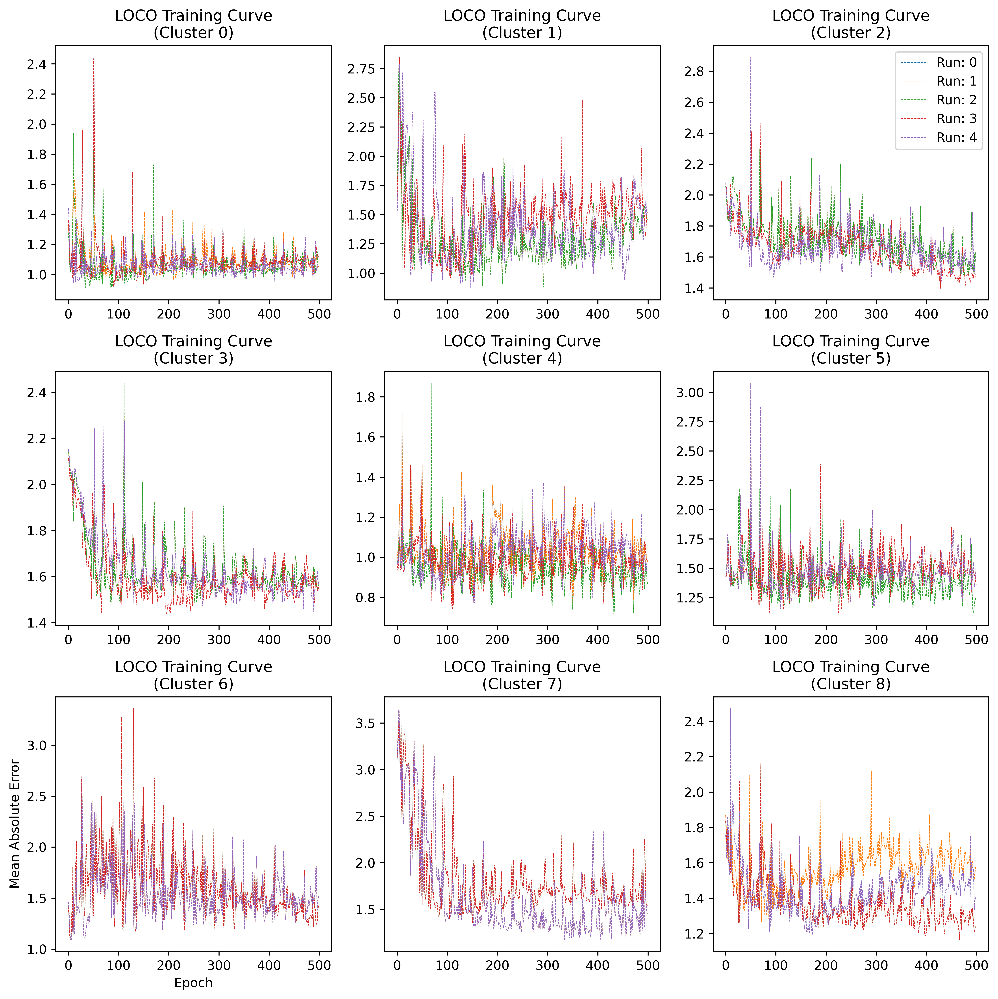

In [8]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm

cmap = cm.get_cmap("tab10")

fig, ax = plt.subplots(nrows=3, ncols=3, figsize=(11, 11), dpi=600)
axes = ax.flat 

for i in range(9):
    for run in range(5):
        x = pk.load(open(f"results/training_curves/LOCO_CrabNet_Reg_run_{run}_fold_{i}.pk", "rb"))
        axes[i].plot(range(len(x['regression'])), [y['MAE'] for y in x['regression']], color=cmap(run), linewidth=0.5, label=f"Run: {run}", ls="--")

    axes[i].set_title(f"LOCO Training Curve\n(Cluster {i})")

axes[6].set_xlabel("Epoch")
axes[6].set_ylabel("Mean Absolute Error")
axes[2].legend()
fig.tight_layout()

fig.savefig("img/SupplementaryFigure5.eps")

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


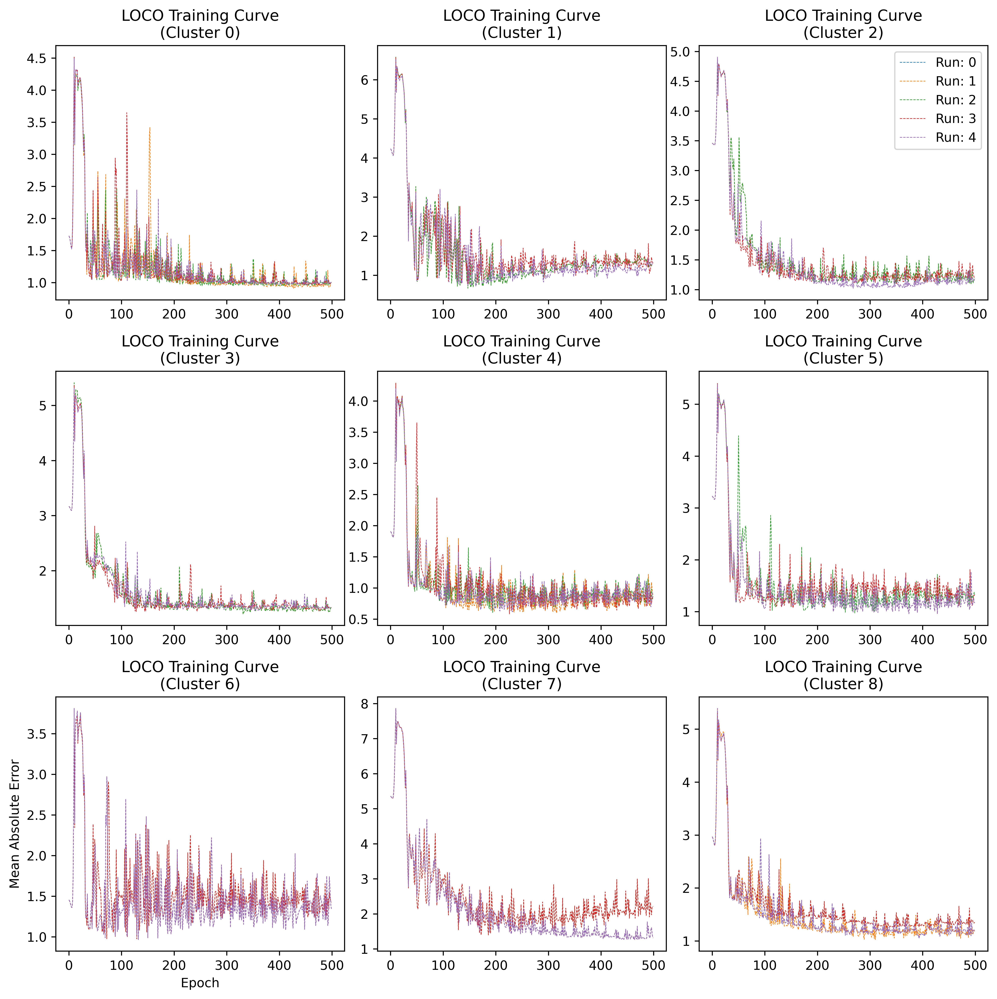

In [9]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm

cmap = cm.get_cmap("tab10")

fig, ax = plt.subplots(nrows=3, ncols=3, figsize=(11, 11), dpi=600)
axes = ax.flat 

for i in range(9):
    for run in range(5):
        x = pk.load(open(f"results/training_curves/LOCO_TransferCrabNet_Reg_run_{run}_fold_{i}.pk", "rb"))
        axes[i].plot(range(len(x['regression'])), [y['MAE'] for y in x['regression']], color=cmap(run), linewidth=0.5, label=f"Run: {run}", ls="--")

    axes[i].set_title(f"LOCO Training Curve\n(Cluster {i})")

axes[6].set_xlabel("Epoch")
axes[6].set_ylabel("Mean Absolute Error")
axes[2].legend()
fig.tight_layout()

fig.savefig("img/SupplementaryFigure6.eps")

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


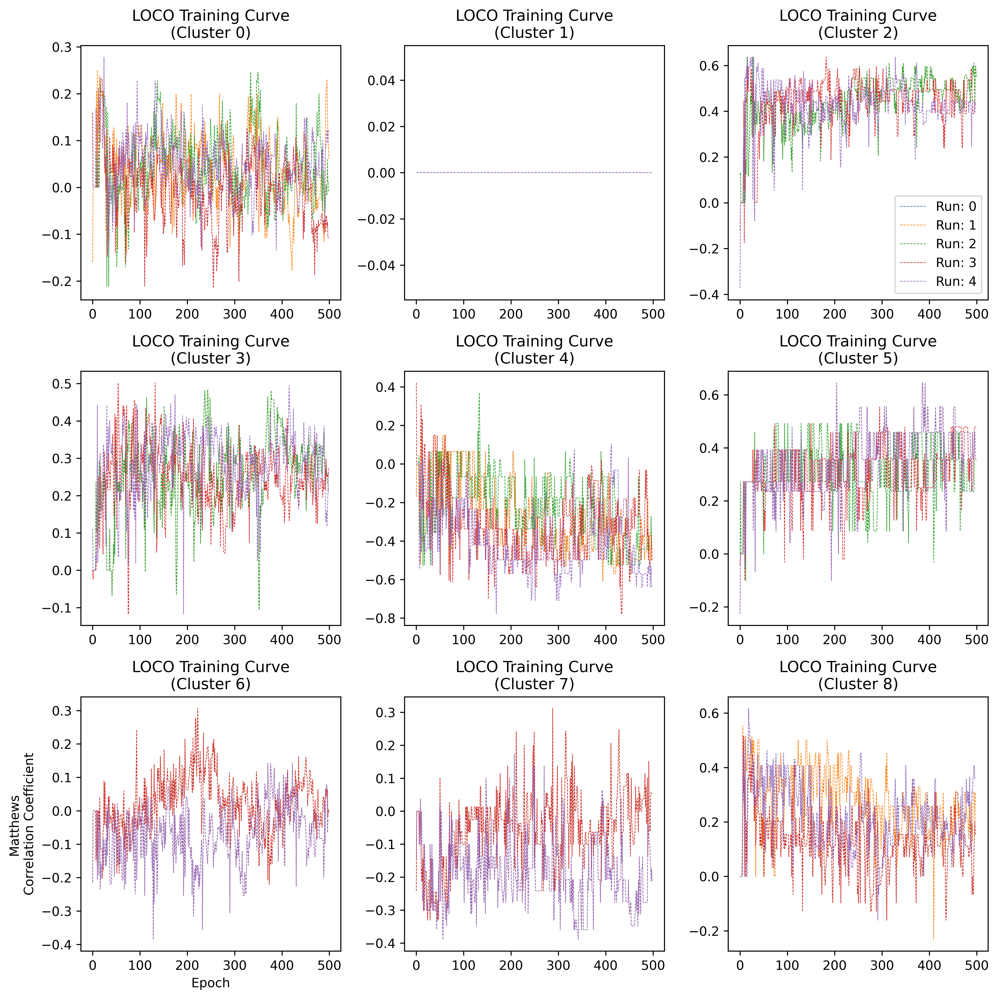

In [10]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm

cmap = cm.get_cmap("tab10")

fig, ax = plt.subplots(nrows=3, ncols=3, figsize=(11, 11), dpi=600)
axes = ax.flat 

# for j, model in enumerate(["LOCO_CrabNet_Reg", "LOCO_TransferCrabNet_Reg", "LOCO_CrabNet_Clf", "LOCO_TransferCrabNet_Clf"]):    
for i in range(9):
    for run in range(5):
        x = pk.load(open(f"results/training_curves/LOCO_CrabNet_Clf_run_{run}_fold_{i}.pk", "rb"))
        
        axes[i].plot(range(len(x["classification"])), 
                    [y["MCC"] for y in x["classification"]], 
                    color=cmap(run), 
                    linewidth=0.5, 
                    label=f"Run: {run}", 
                    ls="--")

    axes[i].set_title(f"LOCO Training Curve\n(Cluster {i})")

axes[6].set_xlabel("Epoch")
axes[6].set_ylabel("Matthews \nCorrelation Coefficient")
axes[2].legend(loc="lower right")

fig.tight_layout()
fig.show()

fig.savefig(f"img/SupplementaryFigure7.eps")

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


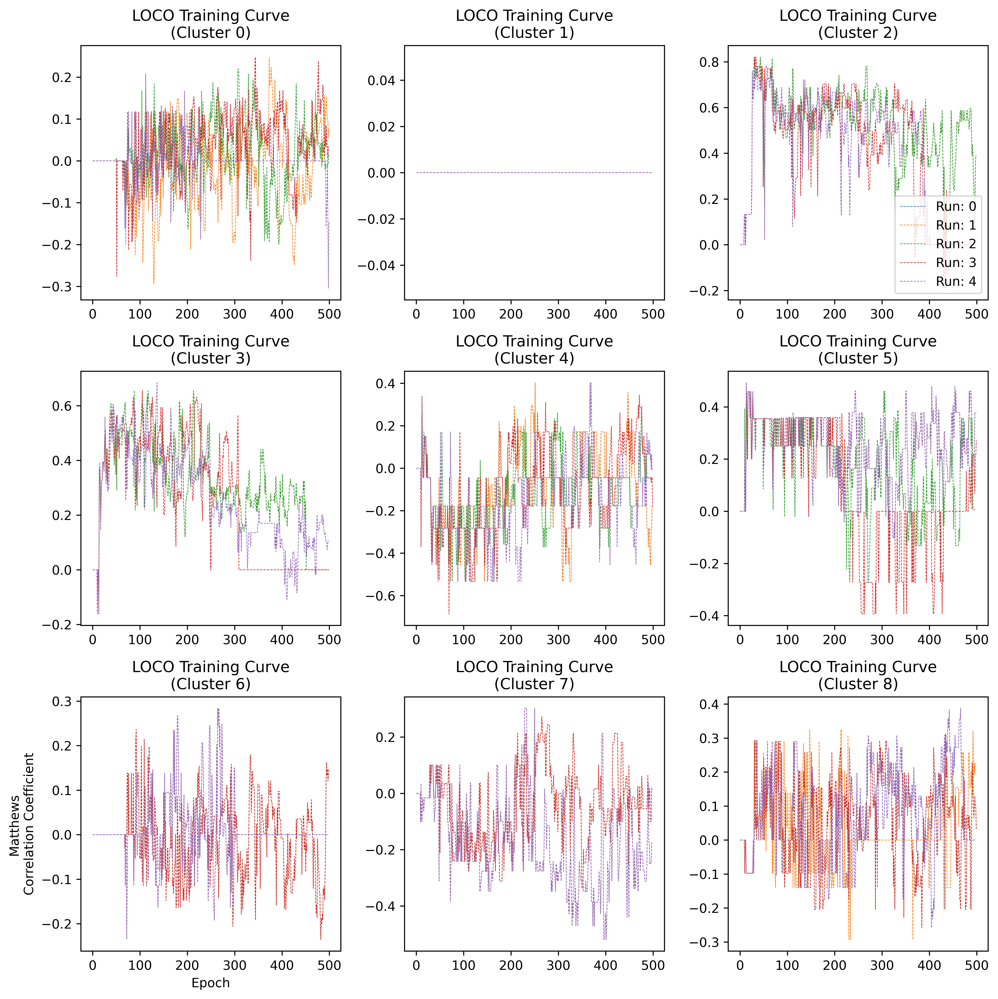

In [11]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm

cmap = cm.get_cmap("tab10")

fig, ax = plt.subplots(nrows=3, ncols=3, figsize=(11, 11), dpi=600)
axes = ax.flat 

# for j, model in enumerate(["LOCO_CrabNet_Reg", "LOCO_TransferCrabNet_Reg", "LOCO_CrabNet_Clf", "LOCO_TransferCrabNet_Clf"]):    
for i in range(9):
    for run in range(5):
        x = pk.load(open(f"results/training_curves/LOCO_TransferCrabNet_Clf_run_{run}_fold_{i}.pk", "rb"))
        
        axes[i].plot(range(len(x["classification"])), 
                    [y["MCC"] for y in x["classification"]], 
                    color=cmap(run), 
                    linewidth=0.5, 
                    label=f"Run: {run}", 
                    ls="--")

    axes[i].set_title(f"LOCO Training Curve\n(Cluster {i})")

axes[6].set_xlabel("Epoch")
axes[6].set_ylabel("Matthews \nCorrelation Coefficient")
axes[2].legend(loc="lower right")

fig.tight_layout()
fig.show()

fig.savefig(f"img/SupplementaryFigure8.eps")